In [1]:
import os, sys, random, json, math, time
from glob import glob
from typing import List, Tuple, Optional
import numpy as np
from PIL import Image
from tqdm.auto import tqdm
from statistics import median
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as T
import torchvision.models as models
import cv2
import matplotlib.pyplot as plt

/home/lovecrush/miniconda3/envs/deeplearning/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
NUM_KEYPOINTS = 14               
INPUT_SIZE = 224
BATCH_SIZE = 1
EPOCHS = 20
LR = 2e-4
WEIGHT_DECAY = 1e-4
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
NUM_WORKERS = 4
SEED = 42
OUTPUT_DIR = "./outputs"
os.makedirs(OUTPUT_DIR, exist_ok=True)

DATA_ROOT = "data"

In [3]:
def set_seed(seed=42):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)

set_seed(SEED)

In [4]:
def find_dataset_root():
    # If user specified path, use it
    if DATA_ROOT:
        return DATA_ROOT
    # Try common Kaggle input paths
    cand = []
    base = DATA_ROOT
    if os.path.exists(base):
        for d in os.listdir(base):
            full = os.path.join(base, d)
            if os.path.isdir(full):
                cand.append(full)
    # heuristics: look for a directory with train/images or data.yaml
    for c in cand:
        for root, dirs, files in os.walk(c):
            if "data.yaml" in files:
                return c
            # detect yolo-pose structure
            if ("train" in dirs and "valid" in dirs) or ("train" in dirs and "val" in dirs):
                return c
    # fallback: first candidate
    return cand[0] if cand else None

ROOT = find_dataset_root()
print("Detected dataset root:", ROOT)
if ROOT is None:
    raise FileNotFoundError("Cannot find dataset in /kaggle/input. Set DATA_ROOT manually.")


Detected dataset root: data


In [5]:
class KeypointsDatasetRoboflow(Dataset):
    def __init__(self, images_dir, labels_dir=None, json_file=None, input_size=224, transforms=None, num_keypoints=14):
        self.images_dir = images_dir
        self.labels_dir = labels_dir
        self.input_size = input_size
        self.num_keypoints = num_keypoints
        self.transforms = transforms
        self.items = []
        
        if json_file and os.path.exists(json_file):
            with open(json_file, "r") as f:
                js = json.load(f)
            for it in js:
                name = it.get("id")
                if name.endswith(".jpg") or name.endswith(".png"):
                    name = os.path.splitext(name)[0]
                img_path = self._find_image_path(name)
                if img_path:
                    self.items.append({"id": name, "img_path": img_path, "kps": it.get("kps")})
        else:
            img_files = sorted([p for p in glob(os.path.join(images_dir, "*")) if p.lower().endswith((".jpg",".jpeg",".png"))])
            for p in img_files:
                base = os.path.splitext(os.path.basename(p))[0]
                txt1 = os.path.join(labels_dir, base + ".txt") if labels_dir else os.path.join(os.path.dirname(p), base+".txt")
                if os.path.exists(txt1):
                    self.items.append({"id": base, "img_path": p, "label_path": txt1})
                else:
                    continue

    def _find_image_path(self, name):
        for ext in [".jpg", ".jpeg", ".png"]:
            p = os.path.join(self.images_dir, name + ext)
            if os.path.exists(p):
                return p
        return None

    def __len__(self):
        return len(self.items)

    def _read_yolopose_txt(self, label_path, img_w, img_h):
        with open(label_path, "r") as f:
            line = f.readline().strip()
        if not line:
            return [[0.0,0.0,0] for _ in range(self.num_keypoints)]
        parts = line.split()
        try:
            nums = [float(x) for x in parts]
        except:
            nums = []
        if len(nums) < 5 + self.num_keypoints * 3:
            rem = nums[5:]
            kps = []
            if len(rem) == self.num_keypoints*2:
                for i in range(self.num_keypoints):
                    nx = rem[2*i]; ny = rem[2*i+1]; v = 2
                    kps.append([nx*img_w, ny*img_h, int(v)])
            else:
                # fallback zeros
                kps = [[0.0,0.0,0] for _ in range(self.num_keypoints)]
            return kps
        rem = nums[5:]
        kps = []
        for i in range(self.num_keypoints):
            nx = rem[3*i]
            ny = rem[3*i+1]
            v = int(rem[3*i+2])
            kps.append([nx*img_w, ny*img_h, v])
        return kps

    def __getitem__(self, idx):
        it = self.items[idx]
        img_path = it["img_path"]
        img = cv2.imread(img_path)
        if img is None:
            raise RuntimeError(f"Cannot read img: {img_path}")
        h,w = img.shape[:2]
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        if "kps" in it:
            kps = it["kps"]
            if len(kps) < self.num_keypoints:
                kps = kps + [[0.0,0.0] for _ in range(self.num_keypoints - len(kps))]
            kps_px = [[float(x), float(y), 2] for (x,y) in kps]
        else:
            kps_px = self._read_yolopose_txt(it["label_path"], w, h)

        target = np.zeros((self.num_keypoints*2,), dtype=np.float32)
        mask = np.zeros((self.num_keypoints,), dtype=np.float32)
        for i, (x_px, y_px, v) in enumerate(kps_px):
            if v > 0:
                mask[i] = 1.0
                nx = float(x_px) / float(w)
                ny = float(y_px) / float(h)
                # clip
                nx = min(max(nx, 0.0), 1.0)
                ny = min(max(ny, 0.0), 1.0)
                target[2*i] = nx
                target[2*i+1] = ny
            else:
                mask[i] = 0.0

        pil = Image.fromarray(img)
        if self.transforms is not None:
            img_t = self.transforms(pil)
        else:
            tf = T.Compose([
                T.Resize((self.input_size, self.input_size)),
                T.ToTensor(),
                T.Normalize(mean=[0.485,0.456,0.406], std=[0.229,0.224,0.225])
            ])
            img_t = tf(pil)
        return img_t, torch.from_numpy(target), torch.from_numpy(mask), os.path.basename(img_path)


In [6]:
train_images = os.path.join(ROOT, "train", "images")
val_images = os.path.join(ROOT, "valid", "images")
if not os.path.exists(val_images):
    val_images = os.path.join(ROOT, "valid", "images")
test_images = os.path.join(ROOT, "test", "images")

train_labels = os.path.join(ROOT, "train", "labels")
val_labels = os.path.join(ROOT, "valid", "labels")
if not os.path.exists(val_labels):
    val_labels = os.path.join(ROOT, "valid", "labels")
test_labels = os.path.join(ROOT, "test", "labels")

if not os.path.exists(train_images):
    for d in ("images","train_images","train_images"):
        p = os.path.join(ROOT, d)
        if os.path.exists(p):
            train_images = p
            break

print("train_images:", train_images, "train_labels:", train_labels)
print("val_images:", val_images, "val_labels:", val_labels)


train_images: data/train/images train_labels: data/train/labels
val_images: data/valid/images val_labels: data/valid/labels


In [7]:
train_tf = T.Compose([
    T.Resize((INPUT_SIZE, INPUT_SIZE)),
    T.RandomHorizontalFlip(p=0.5),
    T.ColorJitter(brightness=0.15, contrast=0.15, saturation=0.15, hue=0.02),
    T.ToTensor(),
    T.Normalize(mean=[0.485,0.456,0.406], std=[0.229,0.224,0.225])
])
val_tf = T.Compose([
    T.Resize((INPUT_SIZE, INPUT_SIZE)),
    T.ToTensor(),
    T.Normalize(mean=[0.485,0.456,0.406], std=[0.229,0.224,0.225])
])

print("Train images path:", train_images)
print("Train labels path:", train_labels)
print("Val images path:", val_images)
print("Val labels path:", val_labels)

train_ds = KeypointsDatasetRoboflow(train_images, labels_dir=train_labels, input_size=INPUT_SIZE, transforms=train_tf, num_keypoints=NUM_KEYPOINTS)
val_ds = KeypointsDatasetRoboflow(val_images, labels_dir=val_labels, input_size=INPUT_SIZE, transforms=val_tf, num_keypoints=NUM_KEYPOINTS)

print("Dataset sizes:", len(train_ds), len(val_ds))
if len(train_ds)==0:
    print("No training samples found. Check dataset structure and paths.")
    # Print files found in train_images and train_labels for debugging
    train_img_files = [f for f in os.listdir(train_images) if f.lower().endswith((".jpg",".jpeg",".png"))]
    train_lbl_files = [f for f in os.listdir(train_labels) if f.lower().endswith(".txt")]
    print("Found image files:", train_img_files[:5])
    print("Found label files:", train_lbl_files[:5])
    raise RuntimeError("No training samples found. Check dataset structure and paths.")

train_loader = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS, pin_memory=True)
val_loader = DataLoader(val_ds, batch_size=BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS, pin_memory=True)


Train images path: data/train/images
Train labels path: data/train/labels
Val images path: data/valid/images
Val labels path: data/valid/labels
Dataset sizes: 1000 233


In [8]:
class ResNetKeypointRegressor(nn.Module):
    def __init__(self, num_keypoints=14, backbone="resnet50", pretrained=True, dropout=0.25):
        super().__init__()
        self.num_kp = num_keypoints
        if backbone=="resnet50":
            self.backbone = models.resnet50(pretrained=pretrained)
            feat_dim = self.backbone.fc.in_features
        else:
            self.backbone = models.resnet50(pretrained=pretrained)
            feat_dim = self.backbone.fc.in_features
        # remove fc
        self.backbone.fc = nn.Identity()
        self.head = nn.Sequential(
            nn.Linear(feat_dim, feat_dim//2),
            nn.ReLU(inplace=True),
            nn.Dropout(dropout),
            nn.Linear(feat_dim//2, num_keypoints*2)
        )

    def forward(self, x):
        f = self.backbone(x)
        out = self.head(f)
        out = torch.sigmoid(out)  
        return out

model = ResNetKeypointRegressor(num_keypoints=NUM_KEYPOINTS).to(DEVICE)
print(model)


/home/lovecrush/miniconda3/envs/deeplearning/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/lovecrush/miniconda3/envs/deeplearning/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


ResNetKeypointRegressor(
  (backbone): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Seque

In [9]:
criterion = nn.SmoothL1Loss(reduction="none")  
optimizer = torch.optim.AdamW(model.parameters(), lr=LR, weight_decay=WEIGHT_DECAY)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=EPOCHS)

scaler = torch.cuda.amp.GradScaler(enabled=(DEVICE=="cuda"))

/tmp/ipykernel_20953/1119685757.py:5: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = torch.cuda.amp.GradScaler(enabled=(DEVICE=="cuda"))


In [10]:
def train_one_epoch(epoch, model, loader, optimizer, device):
    model.train()
    running_loss = 0.0
    n_samples = 0
    pbar = tqdm(loader, desc=f"Train {epoch}")
    for imgs, targets, masks, names in pbar:
        imgs = imgs.to(device, non_blocking=True)
        targets = targets.to(device, non_blocking=True)
        masks = masks.to(device, non_blocking=True)

        optimizer.zero_grad()
        with torch.cuda.amp.autocast(enabled=(device=="cuda")):
            preds = model(imgs)  # [B, 2K] normalized
            loss_map = criterion(preds, targets)  # [B,2K]
            # convert masks to expanded mask over coords
            mask_coords = masks.unsqueeze(-1).repeat(1, 2).view(-1, NUM_KEYPOINTS*2).to(device) if False else None
            # create per-coordinate mask: for each keypoint mask[i] -> coords 2*i,2*i+1
            mask_coords = torch.zeros_like(loss_map)
            for i_k in range(NUM_KEYPOINTS):
                mask_coords[:, 2*i_k] = masks[:, i_k]
                mask_coords[:, 2*i_k+1] = masks[:, i_k]
            loss_masked = loss_map * mask_coords
            # mean only over present coords (avoid dividing by full 2K if many missing)
            denom = mask_coords.sum()
            if denom.item() == 0:
                loss = torch.tensor(0.0, device=device, requires_grad=True)
            else:
                loss = loss_masked.sum() / denom

        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()

        batch_sz = imgs.size(0)
        running_loss += loss.item() * batch_sz
        n_samples += batch_sz
        pbar.set_postfix(loss=running_loss / n_samples)
    return running_loss / max(1, n_samples)


In [11]:
@torch.no_grad()
def validate_and_save_predictions(model, loader, device, out_json_path):
    model.eval()
    all_preds = []
    total_loss = 0.0
    n_samples = 0
    for imgs, targets, masks, names in tqdm(loader, desc="Val"):
        imgs = imgs.to(device, non_blocking=True)
        targets = targets.to(device, non_blocking=True)
        masks = masks.to(device, non_blocking=True)
        with torch.cuda.amp.autocast(enabled=(device=="cuda")):
            preds = model(imgs) 
        preds_np = preds.detach().cpu().numpy()
        targets_np = targets.detach().cpu().numpy()
        masks_np = masks.detach().cpu().numpy()
        bs = preds_np.shape[0]
        for b in range(bs):
            name = names[b]
            img_path = os.path.join(os.path.dirname(loader.dataset.items[0]['img_path']), name)
            # try extensions
            img_full = None
            for ext in (".jpg",".jpeg",".png"):
                p = os.path.join(os.path.dirname(loader.dataset.items[0]['img_path']), name+ext)
                if os.path.exists(p):
                    img_full = p
                    break
            if img_full is None:
                cand = glob(os.path.join(ROOT, "**", name+"*"), recursive=True)
                cand = [c for c in cand if c.lower().endswith((".jpg",".jpeg",".png"))]
                img_full = cand[0] if cand else None
            if img_full:
                im = Image.open(img_full)
                w,h = im.size
            else:
                w,h = INPUT_SIZE, INPUT_SIZE

            pred_list = []
            for k in range(NUM_KEYPOINTS):
                nx = float(preds_np[b, 2*k])
                ny = float(preds_np[b, 2*k+1])
                # clip
                nx = min(max(nx, 0.0), 1.0)
                ny = min(max(ny, 0.0), 1.0)
                x_px = nx * w
                y_px = ny * h
                conf = 1.0
                pred_list.append([x_px, y_px, conf])
            all_preds.append({"id": os.path.splitext(name)[0], "kps": pred_list})
            vis = masks_np[b]
            diffs = preds_np[b] - targets_np[b]
            diffs = diffs.reshape(-1,2)
            sqs = np.sum((diffs**2), axis=1)  # per-keypoint squared error (normalized units squared)
            # only for visible
            if vis.sum() > 0:
                mse = np.mean(sqs[vis==1])
                total_loss += mse
                n_samples += 1
    with open(out_json_path, "w") as f:
        json.dump(all_preds, f, indent=2)
    avg_val_loss = total_loss / n_samples if n_samples>0 else 0.0
    return avg_val_loss, out_json_path


In [12]:
def calculate_pck_from_json(image_folder_path, ground_truth_path, predicted_path, alpha=0.02, confidence_threshold=0.5):
    with open(ground_truth_path,'r') as f:
        gt_data = json.load(f)
    gt_dict = {item['id']: item['kps'] for item in gt_data}
    with open(predicted_path,'r') as f:
        pred_data = json.load(f)
    pred_dict = {item['id']: item['kps'] for item in pred_data}
    total_keypoints = []
    correct_keypoints = []
    for img_id, gt_kps in gt_dict.items():
        if img_id not in pred_dict:
            continue
        pred_kps = pred_dict[img_id]
        img_path = os.path.join(image_folder_path, img_id + ".png")
        if not os.path.exists(img_path):
            img_path = os.path.join(image_folder_path, img_id + ".jpg")
        if not os.path.exists(img_path):
            continue
        try:
            x0,y0 = gt_kps[0]
            x3,y3 = gt_kps[3]
        except:
            x0,y0 = gt_kps[0][0], gt_kps[0][1]
            x3,y3 = gt_kps[3][0], gt_kps[3][1]
        L = math.sqrt((x3-x0)**2 + (y3-y0)**2)
        total_images = 0
        correct_images = 0
        for gt_point, pred_point in zip(gt_kps, pred_kps):
            if len(gt_point)>=2:
                gx,gy = gt_point[0], gt_point[1]
            else:
                continue
            px,py = pred_point[0], pred_point[1]
            conf = pred_point[2] if len(pred_point)>=3 else 1.0
            if conf < confidence_threshold:
                continue
            dist = math.hypot(px-gx, py-gy)
            if dist <= alpha * L:
                correct_images += 1
            total_images += 1
        total_keypoints.append(total_images)
        correct_keypoints.append(correct_images)
    pck = sum(correct_keypoints)/sum(total_keypoints) if sum(total_keypoints)>0 else 0.0
    return pck

def oks_per_instance(gt_kps, pred_kps, area, sigmas=None, confidence_threshold=0.5):
    if sigmas is None:
        sigmas = np.array([0.075]*len(gt_kps))
    gt = np.asarray(gt_kps, dtype=float)
    dt = np.asarray(pred_kps, dtype=float)
    K = gt.shape[0]
    # vis
    vis = np.ones((K,), dtype=bool)
    if gt.shape[1] >= 3:
        vis = (gt[:,2] > 0)
    dt_xy = dt[:, :2]
    scores = dt[:, 2] if dt.shape[1] >= 3 else np.ones((K,))
    # compute s
    if area is None or area<=0:
        try:
            x0,y0 = gt[0,:2]
            x3,y3 = gt[3,:2]
            area = max(1.0, (x3-x0)*(y3-y0))
        except:
            area = 1.0
    s = math.sqrt(0.53 * area)
    oks_sum = 0.0
    cnt = 0
    for i in range(K):
        if not vis[i]:
            continue
        d = math.hypot(dt_xy[i,0]-gt[i,0], dt_xy[i,1]-gt[i,1])
        w = 2 * (s**2) * (sigmas[i]**2)
        val = math.exp(- (d**2) / w)
        oks_sum += val
        cnt += 1
    return oks_sum / cnt if cnt>0 else 0.0

def calculate_average_oks(image_folder_path, ground_truth_path, predicted_path, sigmas=None, confidence_threshold=0.5):
    with open(ground_truth_path,'r') as f:
        gt_list = json.load(f)
    with open(predicted_path,'r') as f:
        pred_list = json.load(f)
    gt_dict = {item['id']: item for item in gt_list}
    pred_dict = {item['id']: item for item in pred_list}
    oks_vals = []
    for img_id, gt_item in gt_dict.items():
        if img_id not in pred_dict:
            oks_vals.append(0.0)
            continue
        gt_kps = gt_item['kps']
        pred_kps = pred_dict[img_id]['kps']
        area = gt_item.get('area', None)
        oks = oks_per_instance(gt_kps, pred_kps, area, sigmas=sigmas, confidence_threshold=confidence_threshold)
        oks_vals.append(oks)
    mean_oks = float(np.mean(oks_vals)) if len(oks_vals)>0 else 0.0
    return mean_oks

def calculate_mean_rmse_per_image(image_folder_path, ground_truth_path, predicted_path, confidence_threshold=0.5):
    with open(ground_truth_path,'r') as f:
        gt_list = json.load(f)
    with open(predicted_path,'r') as f:
        pred_list = json.load(f)
    gt_dict = {item['id']: item['kps'] for item in gt_list}
    pred_dict = {item['id']: item['kps'] for item in pred_list}
    rmses = []
    rmses_norm = []
    for img_id, gt_kps in gt_dict.items():
        if img_id not in pred_dict:
            continue
        pred_kps = pred_dict[img_id]
        se = []
        for g,p in zip(gt_kps, pred_kps):
            gx,gy = g[0], g[1]
            px,py,conf = p[0], p[1], p[2] if len(p)>2 else 1.0
            if conf < confidence_threshold:
                continue
            se.append((px-gx)**2 + (py-gy)**2)
        if len(se)>0:
            mse = np.mean(se)
            rmse = math.sqrt(mse)
            rmses.append(rmse)
            x0,y0 = gt_kps[0][0], gt_kps[0][1]
            x3,y3 = gt_kps[3][0], gt_kps[3][1]
            L = math.hypot(x3-x0, y3-y0)
            rmses_norm.append(rmse / L if L>0 else rmse)
    mean_rmse = float(np.mean(rmses)) if rmses else 0.0
    mean_rmse_norm = float(np.mean(rmses_norm)) if rmses_norm else 0.0
    return mean_rmse, mean_rmse_norm


In [13]:
best_val_rmse = 1e9
best_epoch = -1
for epoch in range(1, EPOCHS+1):
    t0 = time.time()
    train_loss = train_one_epoch(epoch, model, train_loader, optimizer, DEVICE)
    val_rmse_norm, pred_json = None, None
    out_pred = os.path.join(OUTPUT_DIR, f"pred_epoch{epoch}.json")
    val_mse, out_pred = validate_and_save_predictions(model, val_loader, DEVICE, out_pred)
    gt_json_candidates = [
        os.path.join(ROOT, "valid", "ground_truth.json"),
        os.path.join(ROOT, "valid", "ground-truth.json"),
        os.path.join(ROOT, "valid", "ground_truth.json"),
        os.path.join(ROOT, "ground_truth.json"),
        os.path.join(ROOT, "valid", "annotations.json"),
        os.path.join(ROOT, "valid", "labels.json"),
        os.path.join(ROOT, "valid", "gt.json"),
    ]
    gt_json = None
    for g in gt_json_candidates:
        if g and os.path.exists(g):
            gt_json = g
            break
    if gt_json is None:
        gt_temp = []
        for it in val_ds.items:
            name = it['id']
            img_path = it['img_path']
            im = Image.open(img_path)
            w,h = im.size
            if 'label_path' in it and os.path.exists(it['label_path']):
                kps_px = val_ds._read_yolopose_txt(it['label_path'], w, h)
            else:
                kps_px = it.get('kps', [[0,0] for _ in range(NUM_KEYPOINTS)])
                kps_px = [[float(x), float(y), 2] if len(kps_px[0])>=2 else [0,0,0] for x,y in [(kp[0],kp[1]) if len(kp)>=2 else (0,0) for kp in kps_px]]
            area = None
            if len(kps_px)>=4:
                x0,y0 = kps_px[0][0], kps_px[0][1]
                x3,y3 = kps_px[3][0], kps_px[3][1]
                area = abs((x3-x0)*(y3-y0))
            gt_temp.append({"id": name, "kps": [[float(k[0]), float(k[1])] for k in kps_px], "area": area, "bbox": None})
        gt_json = os.path.join(OUTPUT_DIR, f"gt_val_epoch{epoch}.json")
        with open(gt_json, "w") as f:
            json.dump(gt_temp, f, indent=2)
        print("Wrote temporary gt json:", gt_json)

    pck_score = calculate_pck_from_json(os.path.dirname(val_ds.items[0]['img_path']), gt_json, out_pred, alpha=0.02, confidence_threshold=0.5)
    oks_score = calculate_average_oks(os.path.dirname(val_ds.items[0]['img_path']), gt_json, out_pred)
    mean_rmse, mean_rmse_norm = calculate_mean_rmse_per_image(os.path.dirname(val_ds.items[0]['img_path']), gt_json, out_pred)
    t1 = time.time()
    print(f"Epoch {epoch} | train_loss: {train_loss:.6f} | val_mse(normalized) {val_mse:.6f} | PCK {pck_score:.4f} | OKS {oks_score:.4f} | RMSE {mean_rmse:.2f} | RMSE_norm {mean_rmse_norm:.4f} | time {(t1-t0):.1f}s")
    if mean_rmse < best_val_rmse:
        best_val_rmse = mean_rmse
        best_epoch = epoch
        torch.save(model.state_dict(), os.path.join(OUTPUT_DIR, "best_model.pth"))
        print("Saved best model at epoch", epoch)
    scheduler.step()

print("Training finished. Best epoch:", best_epoch, "best_val_rmse:", best_val_rmse)
print("Outputs saved to", OUTPUT_DIR)


Train 1:   0%|          | 0/1000 [00:00<?, ?it/s]/tmp/ipykernel_20953/2562430024.py:12: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=(device=="cuda")):
Val:   0%|          | 0/233 [00:00<?, ?it/s]/tmp/ipykernel_20953/2048650466.py:11: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=(device=="cuda")):
Val: 100%|██████████| 233/233 [00:08<00:00, 27.07it/s]


Wrote temporary gt json: ./outputs/gt_val_epoch1.json
Epoch 1 | train_loss: 0.000907 | val_mse(normalized) 0.008257 | PCK 0.0576 | OKS 0.2417 | RMSE 84.13 | RMSE_norm 0.1056 | time 127.0s
Saved best model at epoch 1


Val: 100%|██████████| 233/233 [00:08<00:00, 26.05it/s]


Wrote temporary gt json: ./outputs/gt_val_epoch2.json
Epoch 2 | train_loss: 0.000426 | val_mse(normalized) 0.006615 | PCK 0.1085 | OKS 0.3017 | RMSE 72.43 | RMSE_norm 0.0911 | time 121.6s
Saved best model at epoch 2


Val: 100%|██████████| 233/233 [00:08<00:00, 27.09it/s]


Wrote temporary gt json: ./outputs/gt_val_epoch3.json
Epoch 3 | train_loss: 0.000371 | val_mse(normalized) 0.006075 | PCK 0.1453 | OKS 0.3455 | RMSE 66.77 | RMSE_norm 0.0849 | time 118.1s
Saved best model at epoch 3


Val: 100%|██████████| 233/233 [00:08<00:00, 27.61it/s]


Wrote temporary gt json: ./outputs/gt_val_epoch4.json
Epoch 4 | train_loss: 0.000326 | val_mse(normalized) 0.004905 | PCK 0.1809 | OKS 0.3817 | RMSE 60.36 | RMSE_norm 0.0763 | time 114.5s
Saved best model at epoch 4


Val: 100%|██████████| 233/233 [00:09<00:00, 25.84it/s]


Wrote temporary gt json: ./outputs/gt_val_epoch5.json
Epoch 5 | train_loss: 0.000299 | val_mse(normalized) 0.004001 | PCK 0.1248 | OKS 0.4116 | RMSE 53.31 | RMSE_norm 0.0679 | time 114.6s
Saved best model at epoch 5


Val: 100%|██████████| 233/233 [00:08<00:00, 27.64it/s]


Wrote temporary gt json: ./outputs/gt_val_epoch6.json
Epoch 6 | train_loss: 0.000235 | val_mse(normalized) 0.003932 | PCK 0.1824 | OKS 0.4491 | RMSE 50.40 | RMSE_norm 0.0645 | time 113.3s
Saved best model at epoch 6


Val: 100%|██████████| 233/233 [00:08<00:00, 27.73it/s]


Wrote temporary gt json: ./outputs/gt_val_epoch7.json
Epoch 7 | train_loss: 0.000240 | val_mse(normalized) 0.006056 | PCK 0.1585 | OKS 0.3712 | RMSE 66.02 | RMSE_norm 0.0828 | time 113.5s


Val: 100%|██████████| 233/233 [00:12<00:00, 18.40it/s]


Wrote temporary gt json: ./outputs/gt_val_epoch8.json
Epoch 8 | train_loss: 0.000202 | val_mse(normalized) 0.003902 | PCK 0.1413 | OKS 0.3974 | RMSE 54.29 | RMSE_norm 0.0682 | time 118.1s


Val: 100%|██████████| 233/233 [00:08<00:00, 26.28it/s]


Wrote temporary gt json: ./outputs/gt_val_epoch9.json
Epoch 9 | train_loss: 0.000186 | val_mse(normalized) 0.005248 | PCK 0.1444 | OKS 0.3702 | RMSE 60.62 | RMSE_norm 0.0773 | time 121.1s


Val: 100%|██████████| 233/233 [00:10<00:00, 22.92it/s]


Wrote temporary gt json: ./outputs/gt_val_epoch10.json
Epoch 10 | train_loss: 0.000188 | val_mse(normalized) 0.004350 | PCK 0.1711 | OKS 0.3993 | RMSE 55.18 | RMSE_norm 0.0700 | time 117.3s


Val: 100%|██████████| 233/233 [00:08<00:00, 26.38it/s]


Wrote temporary gt json: ./outputs/gt_val_epoch11.json
Epoch 11 | train_loss: 0.000177 | val_mse(normalized) 0.004249 | PCK 0.1754 | OKS 0.4233 | RMSE 53.53 | RMSE_norm 0.0683 | time 116.3s


Val: 100%|██████████| 233/233 [00:09<00:00, 25.03it/s]


Wrote temporary gt json: ./outputs/gt_val_epoch12.json
Epoch 12 | train_loss: 0.000170 | val_mse(normalized) 0.006820 | PCK 0.1052 | OKS 0.2904 | RMSE 71.81 | RMSE_norm 0.0914 | time 115.8s


Val: 100%|██████████| 233/233 [00:08<00:00, 26.04it/s]


Wrote temporary gt json: ./outputs/gt_val_epoch13.json
Epoch 13 | train_loss: 0.000166 | val_mse(normalized) 0.006685 | PCK 0.1358 | OKS 0.3522 | RMSE 66.30 | RMSE_norm 0.0848 | time 118.1s


Val: 100%|██████████| 233/233 [00:08<00:00, 26.63it/s]


Wrote temporary gt json: ./outputs/gt_val_epoch14.json
Epoch 14 | train_loss: 0.000153 | val_mse(normalized) 0.003894 | PCK 0.1701 | OKS 0.4118 | RMSE 52.21 | RMSE_norm 0.0662 | time 114.7s


Val: 100%|██████████| 233/233 [00:09<00:00, 23.31it/s]


Wrote temporary gt json: ./outputs/gt_val_epoch15.json
Epoch 15 | train_loss: 0.000148 | val_mse(normalized) 0.003327 | PCK 0.2036 | OKS 0.4683 | RMSE 46.38 | RMSE_norm 0.0590 | time 118.0s
Saved best model at epoch 15


Val: 100%|██████████| 233/233 [00:08<00:00, 28.04it/s]


Wrote temporary gt json: ./outputs/gt_val_epoch16.json
Epoch 16 | train_loss: 0.000148 | val_mse(normalized) 0.004748 | PCK 0.1380 | OKS 0.3570 | RMSE 59.14 | RMSE_norm 0.0752 | time 115.5s


Val: 100%|██████████| 233/233 [00:08<00:00, 28.05it/s]


Wrote temporary gt json: ./outputs/gt_val_epoch17.json
Epoch 17 | train_loss: 0.000137 | val_mse(normalized) 0.003665 | PCK 0.1891 | OKS 0.4311 | RMSE 50.90 | RMSE_norm 0.0635 | time 112.8s


Val: 100%|██████████| 233/233 [00:09<00:00, 25.65it/s]


Wrote temporary gt json: ./outputs/gt_val_epoch18.json
Epoch 18 | train_loss: 0.000136 | val_mse(normalized) 0.004270 | PCK 0.1763 | OKS 0.3938 | RMSE 55.09 | RMSE_norm 0.0697 | time 117.3s


Val: 100%|██████████| 233/233 [00:08<00:00, 27.02it/s]


Wrote temporary gt json: ./outputs/gt_val_epoch19.json
Epoch 19 | train_loss: 0.000133 | val_mse(normalized) 0.004174 | PCK 0.1717 | OKS 0.3879 | RMSE 55.76 | RMSE_norm 0.0708 | time 115.5s


Val: 100%|██████████| 233/233 [00:08<00:00, 27.78it/s]


Wrote temporary gt json: ./outputs/gt_val_epoch20.json
Epoch 20 | train_loss: 0.000130 | val_mse(normalized) 0.004228 | PCK 0.1744 | OKS 0.4204 | RMSE 53.99 | RMSE_norm 0.0673 | time 115.0s
Training finished. Best epoch: 15 best_val_rmse: 46.378195943291296
Outputs saved to ./outputs


In [14]:
test_images = os.path.join(ROOT, "test", "images")
if not os.path.exists(test_images):
    for alt in ("valid","val","train"):
        p = os.path.join(ROOT, alt, "images")
        if os.path.exists(p):
            test_images = p
            break
if not os.path.exists(test_images):
    # try any images folder under root
    cand = glob(os.path.join(ROOT, "**", "images"), recursive=True)
    test_images = cand[0] if cand else None

if test_images is None or not os.path.exists(test_images):
    raise FileNotFoundError(f"Không tìm thấy folder images trong dataset root ({ROOT}).")

print("Using images folder:", test_images)


Using images folder: data/test/images


In [15]:
all_txts = glob(os.path.join(ROOT, "**", "*.txt"), recursive=True)
print("Found total .txt files under dataset root:", len(all_txts))


Found total .txt files under dataset root: 1353


In [16]:
def norm(s):
    import re
    return re.sub(r'[^0-9a-z]', '', s.lower())

In [17]:
def lcs_len(a,b):
    # small strings -> DP ok
    la, lb = len(a), len(b)
    if la==0 or lb==0: return 0
    dp = [0]*(lb+1)
    for i in range(1, la+1):
        prev = 0
        ai = a[i-1]
        for j in range(1, lb+1):
            tmp = dp[j]
            if ai == b[j-1]:
                dp[j] = prev + 1
            else:
                if dp[j-1] > dp[j]:
                    dp[j] = dp[j-1]
                # else keep dp[j]
            prev = tmp
    return dp[lb]

In [18]:
img_files = sorted([p for p in glob(os.path.join(test_images, "*")) if p.lower().endswith((".jpg",".jpeg",".png"))])
print("Found images in folder:", len(img_files))
# build mapping image -> best matching txt using LCS on normalized basenames
txt_basenames = [(t, os.path.splitext(os.path.basename(t))[0], norm(os.path.splitext(os.path.basename(t))[0])) for t in all_txts]

Found images in folder: 118


In [19]:
image_to_label = {}
missed_images = []
for img_path in img_files:
    base = os.path.splitext(os.path.basename(img_path))[0]
    nbase = norm(base)
    best = None
    best_score = -1
    candidate_exact = os.path.join(os.path.dirname(img_path), base + ".txt")
    if os.path.exists(candidate_exact):
        image_to_label[img_path] = candidate_exact
        continue
    for full, bname, nb in txt_basenames:
        if nbase == nb:
            best = full
            best_score = len(nbase)
            break
        if nbase in nb or nb in nbase:
            sc = max(len(nbase), len(nb))
            if sc > best_score:
                best = full; best_score = sc
        else:
            sc = lcs_len(nbase, nb)
            if sc > best_score:
                best = full; best_score = sc
    if best is not None and best_score >= max(1, int(0.5*len(nbase))):
        image_to_label[img_path] = best
    else:
        missed_images.append(img_path)

print(f"Matched labels for {len(image_to_label)} images; {len(missed_images)} images missing matched label files.")
if len(missed_images)>0:
    print("Example missed images (up to 10):")
    for p in missed_images[:10]:
        print(" -", os.path.basename(p))


Matched labels for 118 images; 0 images missing matched label files.


In [20]:
test_items = []
for img_path, label_path in image_to_label.items():
    test_items.append({"img_path": img_path, "label_path": label_path, "id": os.path.splitext(os.path.basename(img_path))[0]})

if len(test_items) == 0:
    raise RuntimeError("Không có ảnh test nào được gán nhãn. Kiểm tra file .txt tồn tại và tên file nhãn.")

print("Test items to evaluate:", len(test_items))

Test items to evaluate: 118


In [21]:
def parse_roboflow_txt(label_path, img_w, img_h, num_kp=NUM_KEYPOINTS):
    with open(label_path, "r") as f:
        lines = [ln.strip() for ln in f.read().splitlines() if ln.strip()]
    if len(lines)==0:
        return [[0.0,0.0,0] for _ in range(num_kp)]
    chosen = None
    for ln in lines:
        parts = ln.split()
        if len(parts)>0:
            try:
                if int(float(parts[0])) == 0:
                    chosen = ln
                    break
            except:
                chosen = ln
                break
    if chosen is None:
        chosen = lines[0]
    parts = chosen.split()
    nums = []
    for p in parts:
        try:
            nums.append(float(p))
        except:
            pass
    if len(nums) < 5:
        return [[0.0,0.0,0] for _ in range(num_kp)]
    rem = nums[5:]
    if len(rem) >= num_kp*3:
        kps = []
        for i in range(num_kp):
            nx = rem[3*i]; ny = rem[3*i+1]; v = int(rem[3*i+2])
            kps.append([nx*img_w, ny*img_h, v])
        return kps
    if len(rem) >= num_kp*2:
        kps = []
        for i in range(num_kp):
            nx = rem[2*i]; ny = rem[2*i+1]
            kps.append([nx*img_w, ny*img_h, 2])
        return kps
    return [[0.0,0.0,0] for _ in range(num_kp)]


In [22]:
BEST_MODEL_PATH = "/kaggle/working/court_kp_outputs/best_model.pth"
def find_checkpoint():
    if BEST_MODEL_PATH:
        if os.path.exists(BEST_MODEL_PATH): return BEST_MODEL_PATH
        else: print("BEST_MODEL_PATH provided but not found:", BEST_MODEL_PATH)
    candidates = [
        "/kaggle/working/court_kp_outputs/best_model.pth",
        "/kaggle/working/court_kp_outputs/best_model.pt",
        "/kaggle/working/best_model.pth",
        "/kaggle/working/best_model.pt",
        "/kaggle/working/model.pth",
        "/kaggle/working/model.pt",
        os.path.join(ROOT, "best_model.pth"),
        os.path.join(ROOT, "model.pth"),
    ]
    # add any .pth in working and root
    candidates += glob("/kaggle/working/**/*.pth", recursive=True)
    candidates += glob(os.path.join(ROOT, "**", "*.pth"), recursive=True)
    for c in candidates:
        if c and os.path.exists(c):
            return c
    return None

ckpt = find_checkpoint()
print("Checkpoint chosen:", ckpt)


BEST_MODEL_PATH provided but not found: /kaggle/working/court_kp_outputs/best_model.pth
Checkpoint chosen: None


In [23]:
model = ResNetKeypointRegressor(num_keypoints=NUM_KEYPOINTS, pretrained=False).to(DEVICE)
if ckpt is not None:
    sd = torch.load(ckpt, map_location=DEVICE)
    if isinstance(sd, dict) and 'state_dict' in sd:
        sd = sd['state_dict']
    new_sd = {}
    for k,v in sd.items():
        nk = k.replace("module.", "") if k.startswith("module.") else k
        new_sd[nk] = v
    try:
        model.load_state_dict(new_sd)
        print("Loaded checkpoint:", ckpt)
    except Exception as e:
        print("Warning: failed to load state_dict directly:", e)
else:
    print("Warning: no checkpoint found. Running with untrained model (results meaningless).")

model.eval()

tf = T.Compose([T.Resize((INPUT_SIZE, INPUT_SIZE)), T.ToTensor(),
                T.Normalize(mean=[0.485,0.456,0.406], std=[0.229,0.224,0.225])])


/home/lovecrush/miniconda3/envs/deeplearning/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


In [24]:
pred_list = []
times = []
gt_list = []
for it in tqdm(test_items, desc="Inference"):
    img_path = it["img_path"]; label_path = it["label_path"]; idn = it["id"]
    pil = Image.open(img_path).convert("RGB")
    w,h = pil.size
    # GT
    gt_kps_px = parse_roboflow_txt(label_path, w, h, num_kp=NUM_KEYPOINTS)
    gt_list.append({"id": idn, "kps": [[float(x),float(y)] for (x,y,_) in gt_kps_px], "area": None})
    # infer
    x = tf(pil).unsqueeze(0).to(DEVICE)
    t0 = time.time()
    with torch.no_grad():
        out = model(x)
    if DEVICE=="cuda": torch.cuda.synchronize()
    t1 = time.time()
    times.append(t1 - t0)
    out_np = out.cpu().numpy()[0]
    kps_pred = []
    for k in range(NUM_KEYPOINTS):
        nx = float(np.clip(out_np[2*k],0.0,1.0))
        ny = float(np.clip(out_np[2*k+1],0.0,1.0))
        px = nx * w; py = ny * h
        kps_pred.append([px, py, 1.0])
    pred_list.append({"id": idn, "kps": kps_pred, "img_path": img_path})

# save predicted json
pred_json_path = os.path.join(OUTPUT_DIR, "predicted_test.json")
with open(pred_json_path, "w") as f:
    json.dump([{"id":p["id"], "kps": p["kps"]} for p in pred_list], f, indent=2)
# save gt json
gt_json_path = os.path.join(OUTPUT_DIR, "gt_test.json")
with open(gt_json_path, "w") as f:
    json.dump([{"id":g["id"], "kps": g["kps"], "area": g["area"]} for g in gt_list], f, indent=2)

print("Saved pred json:", pred_json_path)
print("Saved gt json:", gt_json_path)

Inference: 100%|██████████| 118/118 [00:02<00:00, 49.50it/s]

Saved pred json: ./outputs/predicted_test.json
Saved gt json: ./outputs/gt_test.json


In [25]:
ALPHA_PCK = 0.02
CONF_TH = 0.5
SIGMAS = np.array([0.075,0.075,0.060,0.060,0.0725,0.0725,0.0575,0.0575,0.07,0.07,0.055,0.055,0.055,0.04])
NUM_SHOW = 118

In [26]:
def compute_pck(gt_list, pred_list, alpha=ALPHA_PCK, conf_th=CONF_TH):
    gt_d = {g['id']:g['kps'] for g in gt_list}
    pred_d = {p['id']:p['kps'] for p in pred_list}
    total=0; correct=0; per_img={}
    for idn,gkps in gt_d.items():
        if idn not in pred_d:
            per_img[idn]=0.0; continue
        pkps=pred_d[idn]
        x0,y0 = gkps[0][0], gkps[0][1]; x3,y3 = gkps[3][0], gkps[3][1]
        L = math.hypot(x3-x0, y3-y0) if (x3!=x0 or y3!=y0) else 1.0
        tot=0; corr=0
        for g,p in zip(gkps, pkps):
            gx,gy = g[0], g[1]; px,py,conf = p[0], p[1], p[2] if len(p)>2 else 1.0
            if conf < conf_th: continue
            tot+=1
            if math.hypot(px-gx, py-gy) <= alpha*L:
                corr+=1
        per_img[idn] = corr/tot if tot>0 else 0.0
        total += tot; correct += corr
    overall = correct/total if total>0 else 0.0
    return overall, per_img

def oks_instance(gt_kps, pred_kps, area=None, sigmas=SIGMAS):
    gt = np.array(gt_kps, dtype=float)
    dt = np.array(pred_kps, dtype=float)
    K = gt.shape[0]
    if area is None or area<=0:
        try:
            x0,y0 = gt[0,:2]; x3,y3 = gt[3,:2]; area = max(1.0, (x3-x0)*(y3-y0))
        except:
            area = 1.0
    s = math.sqrt(0.53 * area)
    oks_sum=0.0; cnt=0
    for i in range(K):
        d = math.hypot(float(dt[i,0]) - float(gt[i,0]), float(dt[i,1]) - float(gt[i,1]))
        w = 2*(s**2)*(sigmas[i]**2)
        oks_sum += math.exp(-(d**2)/w)
        cnt += 1
    return oks_sum/cnt if cnt>0 else 0.0

def compute_oks(gt_list, pred_list):
    pred_d = {p['id']:p for p in pred_list}
    oks_vals=[]
    for g in gt_list:
        pid = g['id']
        if pid not in pred_d:
            oks_vals.append(0.0); continue
        oks_vals.append(oks_instance(g['kps'], pred_d[pid]['kps'], area=g.get('area',None)))
    return float(np.mean(oks_vals)) if oks_vals else 0.0

def compute_rmse(gt_list, pred_list, conf_th=CONF_TH):
    pred_d = {p['id']:p for p in pred_list}
    rmses=[]; per_img={}
    rmses_norm=[]
    for g in gt_list:
        pid = g['id']
        if pid not in pred_d:
            per_img[pid] = None; continue
        seq=[]
        for gp,pp in zip(g['kps'], pred_d[pid]['kps']):
            gx,gy = gp[0], gp[1]; px,py = pp[0], pp[1]; conf = pp[2] if len(pp)>2 else 1.0
            if conf < conf_th: continue
            seq.append((px-gx)**2 + (py-gy)**2)
        if len(seq)==0:
            per_img[pid] = None; continue
        mse = float(np.mean(seq)); rmse = math.sqrt(mse)
        rmses.append(rmse)
        x0,y0 = g['kps'][0][0], g['kps'][0][1]; x3,y3 = g['kps'][3][0], g['kps'][3][1]
        L = math.hypot(x3-x0, y3-y0) if (x3!=x0 or y3!=y0) else 1.0
        rmses_norm.append(rmse / L)
        per_img[pid] = rmse
    mean_rmse = float(np.mean(rmses)) if rmses else 0.0
    mean_rmse_norm = float(np.mean(rmses_norm)) if rmses_norm else 0.0
    return mean_rmse, mean_rmse_norm, per_img


In [27]:
pred_compact = [{"id":p["id"], "kps": p["kps"]} for p in pred_list]
gt_compact = [{"id":g["id"], "kps": g["kps"], "area": g.get("area", None)} for g in gt_list]

pck, pck_per_image = compute_pck(gt_compact, pred_compact, alpha=ALPHA_PCK, conf_th=CONF_TH)
oks = compute_oks(gt_compact, pred_compact)
mean_rmse, mean_rmse_norm, rmse_per_image = compute_rmse(gt_compact, pred_compact, conf_th=CONF_TH)

inf_avg = float(np.mean(times)) if len(times)>0 else 0.0
inf_med = float(median(times)) if len(times)>0 else 0.0

metrics = {
    "PCK": pck,
    "OKS": oks,
    "RMSE_pixel_mean": mean_rmse,
    "RMSE_norm_mean": mean_rmse_norm,
    "Inference_avg_s": inf_avg,
    "Inference_median_s": inf_med,
    "Num_evaluated_images": len(pred_list)
}
print("\n=== Evaluation summary ===")
for k,v in metrics.items():
    print(f"{k}: {v}")


=== Evaluation summary ===
PCK: 0.0
OKS: 3.1628731099049684e-07
RMSE_pixel_mean: 750.4870911271623
RMSE_norm_mean: 0.8625884164404907
Inference_avg_s: 0.008149633973331774
Inference_median_s: 0.007651090621948242
Num_evaluated_images: 118


In [28]:
with open(os.path.join(OUTPUT_DIR, "metrics.json"), "w") as f: json.dump(metrics, f, indent=2)
pd.DataFrame([metrics]).T.to_csv(os.path.join(OUTPUT_DIR, "metrics_table.csv"))

df_rows = []
for g in gt_list:
    pid = g["id"]
    df_rows.append({"id": pid, "rmse": rmse_per_image.get(pid, None), "pck": pck_per_image.get(pid, None)})
pd.DataFrame(df_rows).to_csv(os.path.join(OUTPUT_DIR, "per_image_metrics.csv"), index=False)

print("Saved outputs to", OUTPUT_DIR)

Saved outputs to ./outputs


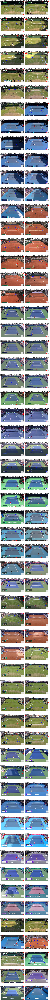

In [29]:
def plot_examples(n_show=NUM_SHOW):
    n_show = min(n_show, len(pred_list))
    idxs = list(range(0, len(pred_list), max(1, len(pred_list)//n_show)))[:n_show]
    cols = 2; rows = (len(idxs)+cols-1)//cols
    plt.figure(figsize=(6*cols, 4*rows))
    for i, idx in enumerate(idxs):
        p = pred_list[idx]
        g = next((gg for gg in gt_list if gg["id"]==p["id"]), None)
        pil = Image.open(p["img_path"]).convert("RGB")
        ax = plt.subplot(rows, cols, i+1)
        ax.imshow(pil); ax.axis("off"); ax.set_title(p["id"])
        if g:
            gxs = [kp[0] for kp in g["kps"]]; gys = [kp[1] for kp in g["kps"]]
            ax.scatter(gxs, gys, s=40, marker='o', facecolors='none', edgecolors='b', label='GT')
        pxs = [kp[0] for kp in p["kps"]]; pys = [kp[1] for kp in p["kps"]]
        ax.scatter(pxs, pys, s=30, marker='x', color='r', label='Pred')
        rmse_val = rmse_per_image.get(p["id"], None)
        if rmse_val is not None:
            ax.text(5,15, f"RMSE: {rmse_val:.1f}", color='white', fontsize=10, bbox=dict(facecolor='black', alpha=0.5))
        ax.legend(loc='lower right')
    plt.tight_layout()
    plt.show()

plot_examples(NUM_SHOW)


Top 20 worst images by RMSE:
1. match_41_002460_png_jpg.rf.d280a1d9c906c8cfd0e9a74222c49378 -> RMSE 1008.31
2. test_image_7_png_jpg.rf.59537d4fe639f425553860002d6475fd -> RMSE 1006.90
3. test_image_4_png_jpg.rf.723e298b3ad6033d5a42d7560fee4dde -> RMSE 1006.76
4. match_41_005800_png_jpg.rf.309358818dfb6132431b7f53128d35b4 -> RMSE 1003.42
5. match_56_001560_png_jpg.rf.33950ead868afb20ecd5ab9638a4781f -> RMSE 1002.30
6. match_49_007000_png_jpg.rf.77e643d538f98cd3870ad0ab6a65df45 -> RMSE 999.94
7. test_image_1_png_jpg.rf.c637dc1f7f9f7e7cef2e24332a372625 -> RMSE 997.01
8. test_image_10_png_jpg.rf.f386fada46acf435705be598393d8e26 -> RMSE 996.64
9. match_56_005480_png_jpg.rf.b13857b318fe3a7d006f6fd491d114ac -> RMSE 990.20
10. test_image_2_png_jpg.rf.61bf2789909810d5bac9b70fe781afa7 -> RMSE 990.14
11. match_56_000040_png_jpg.rf.a657009517b3df02e87641cee64b440f -> RMSE 988.85
12. match_49_004240_png_jpg.rf.754b7af1e854818e4cadc4a64a4a8e44 -> RMSE 980.20
13. test_image_5_png_jpg.rf.56d99455224d

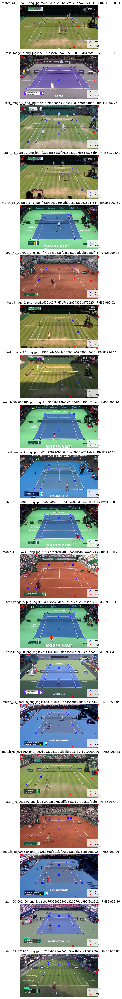

Done. Files in: ./outputs


In [30]:
valid_rmse = [(k,v) for k,v in rmse_per_image.items() if v is not None]
valid_rmse.sort(key=lambda x: x[1], reverse=True)
topk = min(20, len(valid_rmse))
if topk>0:
    print(f"\nTop {topk} worst images by RMSE:")
    for i, (pid, val) in enumerate(valid_rmse[:topk]):
        print(f"{i+1}. {pid} -> RMSE {val:.2f}")
    plt.figure(figsize=(12, 3*topk))
    for i, (pid,val) in enumerate(valid_rmse[:topk]):
        p = next((pp for pp in pred_list if pp['id']==pid), None)
        g = next((gg for gg in gt_list if gg['id']==pid), None)
        if p is None or g is None: continue
        pil = Image.open(p["img_path"]).convert("RGB")
        ax = plt.subplot(topk, 1, i+1)
        ax.imshow(pil); ax.axis("off"); ax.set_title(f"{pid} - RMSE {val:.2f}")
        gxs = [kp[0] for kp in g["kps"]]; gys = [kp[1] for kp in g["kps"]]
        ax.scatter(gxs, gys, s=40, marker='o', facecolors='none', edgecolors='b', label='GT')
        pxs = [kp[0] for kp in p["kps"]]; pys = [kp[1] for kp in p["kps"]]
        ax.scatter(pxs, pys, s=30, marker='x', color='r', label='Pred')
        ax.legend(loc='lower right')
    plt.tight_layout()
    plt.show()

print("Done. Files in:", OUTPUT_DIR)
